# FDM Oblig
###### Rapport av Nils Erlend Heggem
###### I samarbeid med Marte Kristoffersen, Tone Marie Løvseth Hognestad og Jon Skjelsbæk

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

def firstGraph(xList, yList, liftX, liftY, leftFix, rightFix, totalLen):
    for i, x in enumerate(xList):
        if (x < liftX):
            yList[i] = ((liftY - leftFix) / liftX) * x + leftFix
        else:
            yList[i] = (((rightFix - liftY) / (totalLen - liftX)) * x + (rightFix - (((rightFix - liftY) / (totalLen - liftX))) * totalLen))
    return

def fixEnds(u, leftFix, rightFix):
    for i, y in enumerate(u):
        y[0] = leftFix
        y[-1] = rightFix

def FDMsolver(x, timeAmounts, hx, ht, c, liftX, liftY, leftFix, rightFix, totalLen):
    u = timeAmounts * [np.zeros(len(x))]
    
    firstGraph(x, u[0], liftX, liftY, leftFix, rightFix, totalLen)
    #u[1] = u[0].copy() +hx*2
    u[1] = u[0].copy()
    
    fixEnds(u, leftFix, rightFix)
    
    tester1 = u[0].copy()
    
    for i in range(2, len(u)):
        #u[i] = (c**2 * ht**2 * (u[i-1][2:] - 2*u[i-1][1:-2] + u[i-1][:-3]))
        for j in range(1, len(u[i]) - 1):
            pass
            #print(type((c**2 * ht**2 * (u[i-1][j+1] - 2*u[i-1][j] + u[i-1][j-1])) / (hx**2) + 2*u[i-1][j] - u[i-2][j]))
            #u[i][j] = (c**2 * ht**2 * (u[i-1][j+1] - 2*u[i-1][j] + u[i-1][j-1])) / (hx**2) + 2*u[i-1][j] - u[i-2][j]
        #u[i] = u[i] * 1
        
    #print(tester1 == u[0])
                       
    return u

def FDMsolver2():
    x = np.linspace(0,9,10)
    print(x)
    print(x[:-1])
    print(x[1:])
    x = x[:-1] - x[1:]
    print(x)


0.01001001001001001


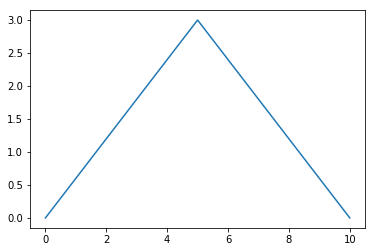

In [68]:
def firstGraphBelow(x, liftX, liftY, leftFix):
    return ((liftY - leftFix) / liftX) * x + leftFix

def firstGraphAbove(x, liftX, liftY, rightFix, totalLen):
    return (((rightFix - liftY) / (totalLen - liftX)) * x + (rightFix - (((rightFix - liftY) / (totalLen - liftX))) * totalLen))

def firstGraphFull(x, h, liftX, liftY, leftFix, rightFix):
    u_0 = np.zeros(len(x))
    if liftX == 0:
        liftIndex = 0
    else:
        liftIndex = int((liftX - x[0]) // h) + 1
        u_0[:liftIndex] = firstGraphBelow(x[:liftIndex], liftX, liftY, leftFix)
    #print(x[:liftIndex])
    
    #print(x[:liftIndex])
    #print(x[liftIndex:])
    
    u_0[liftIndex:] = firstGraphAbove(x[liftIndex:], liftX, liftY, rightFix, x[-1])
    
    return u_0

def firstGraph2point0(x):
    return -0.12*(x**2) + 1.2*x


def secondGraph(x, u_0, C):
    u_1 = np.zeros(len(x))
    u_1[0] = u_0[0]
    u_1[-1] = u_0[-1]
    u_1[1:-1] = u_0[1:-1] - 0.5*(C**2)*(u_0[2:] - 2*u_0[1:-1] + u_0[:-2])
    return u_1
    
def remainingGraphs(u, C):
    #newU = u.copy()
    u[:,0] = u[0,0]
    u[:,-1] = u[0,-1]
    #u[2:,1:-1] = 2*u[1:-1,1:-1] - u[:-2,1:-1] + C**2 * (u[1:-1,2:] - 2 * u[1:-1,1:-1] + u[1:-1,:-2])
    for i in range(2, len(u)):
        u[i,1:-1] = 2*u[i-1,1:-1] - u[i-2,1:-1] + C**2 * (u[i-1,2:] - 2 * u[i-1,1:-1] + u[i-1,:-2])

x,h = np.linspace(0, 10, 1000, retstep=True)
print(h)
#print(x[10:])
timeAmounts = 3000
timeSteps = 0.1
c = 0.1
C = c*(timeSteps / h)

u = np.zeros([timeAmounts,len(x)])
u[0] = firstGraphFull(x, h, 5, 3, 0, 0)
#u[0] = firstGraph2point0(x)

#u[1] = secondGraph(x, u[0], C)
u[1] = u[0] + 5*h

remainingGraphs(u, C)

#u[0,:-10] = firstGraphBelow(x[:-10], 5, 2, 0, 0, 10)
#u[0,10:] = firstGraphAbove(x[10:], 5, 2, 0, 0, 10)
#print(u[0])
#print(u[2:,2:])
#print(x[1:-1])
#print(x[:-2])
#u = (u[2:] - 3*u[1:-1] + u[:-2])
#print(x)

#print(u[3])
#print(u[4])

plt.plot(x,u[0])
#for i in range(0, len(u), 50):
 #   plt.plot(x,u[i])
plt.show()

In [167]:
x, h = np.linspace(0, 10, 100, retstep=True)

y = x.copy()

u = FDMsolver(x, 400, h, h, 1, 5, 2, 0, 0, 10)
firstGraph(x, y, 5, 2, 0, 0, 10)

In [210]:
#plt.axis((0,10,0,3))
#plt.plot(x,u[0])
#plt.show()
FDMsolver2()

[0. 1. 2. 3. 4. 5. 6. 7. 8. 9.]
[0. 1. 2. 3. 4. 5. 6. 7. 8.]
[1. 2. 3. 4. 5. 6. 7. 8. 9.]
[-1. -1. -1. -1. -1. -1. -1. -1. -1.]


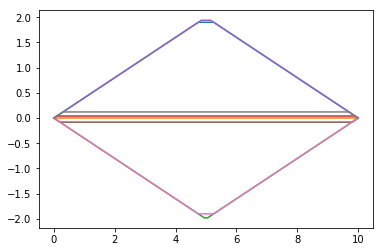

In [128]:
for i in range(0,len(u),50):
    plt.plot(x,u[i])
plt.show()

Animation size has reached 20972490 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


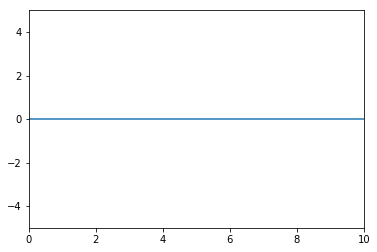

In [63]:
fig, ax = plt.subplots()
ax.axis([0,10,-5,5])
l, = ax.plot([],[])

def animate(i):
    l.set_data(x, u[i])

ani = animation.FuncAnimation(fig, animate, frames=len(u), interval=1)

HTML(ani.to_jshtml())


$17\cdot y=1 \quad (mod\,43)$

$43 = 17(2) + 9 \quad (mod\,43)$

$17 = 9(1) + 8 \quad (mod\,43)$

$9 = 8(1) + 1 \quad (mod\,43)$

$8 = 1(8) + 0 \quad (mod\,43)$


$9 = 43 - 17(2) \quad (mod\,43)$

$8 = 17 - 9(1) \quad (mod\,43)$

$1 = 9 - 8(1) \quad (mod\,43)$


$1 = 9 - 8(1) \quad (mod\,43)$

$1 = 9 - (17 - 9(1))(1) \quad (mod\,43)$

$1 = 9(2) - 17(1) \quad (mod\,43)$

$1 = (43 - 17(2))(2) - 17(1) \quad (mod\,43)$

$1 = 43(2) - 17(5) \quad (mod\,43)$

$43(2) = 0 \quad (mod\,43)$

$1 = 17\cdot (-5) \quad (mod\,43)$

$-5 = 38  \quad (mod\,43)$

$1 = 17\cdot 38  \quad (mod\,43)$

$y = 38$